In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook
%matplotlib inline

In [3]:
import tensorflow
print (tensorflow.__version__)

2.4.0


In [4]:
from google.colab import drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [4]:
!unzip /content/gdrive/MyDrive/GAN_datasets/selfie2anime.zip -d /

Streaming output truncated to the last 5000 lines.
  inflating: /trainA/female_26059.jpg  
  inflating: /trainA/female_26076.jpg  
  inflating: /trainA/female_26092.jpg  
  inflating: /trainA/female_26125.jpg  
  inflating: /trainA/female_26139.jpg  
  inflating: /trainA/female_26145.jpg  
  inflating: /trainA/female_26149.jpg  
  inflating: /trainA/female_26157.jpg  
  inflating: /trainA/female_26167.jpg  
  inflating: /trainA/female_26181.jpg  
  inflating: /trainA/female_26190.jpg  
  inflating: /trainA/female_26195.jpg  
  inflating: /trainA/female_26219.jpg  
  inflating: /trainA/female_26223.jpg  
  inflating: /trainA/female_26226.jpg  
  inflating: /trainA/female_26227.jpg  
  inflating: /trainA/female_26231.jpg  
  inflating: /trainA/female_26239.jpg  
  inflating: /trainA/female_26241.jpg  
  inflating: /trainA/female_26247.jpg  
  inflating: /trainA/female_26273.jpg  
  inflating: /trainA/female_26278.jpg  
  inflating: /trainA/female_26279.jpg  
  inflating: /trainA/female_2

In [5]:
import glob
faces = glob.glob('/trainA/*.jpg')
animes = glob.glob("/trainB/*.jpg")
faces_test = glob.glob('/testA/*.jpg')
animes_test = glob.glob("/testB/*.jpg")

In [6]:
len(faces), len(animes), len(faces_test), len(animes_test)

(3400, 3400, 100, 100)

In [7]:
import cv2
for file in faces[:10]:
    img = cv2.imread(file)
    print (img.shape)

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


Human Faces


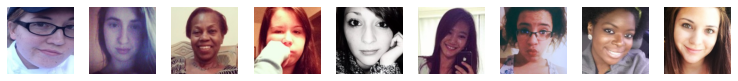

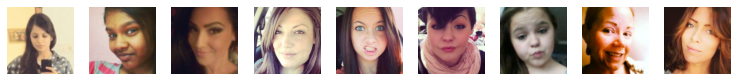

--------------------------------------------------------------------------------
Anime Faces


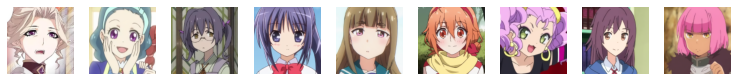

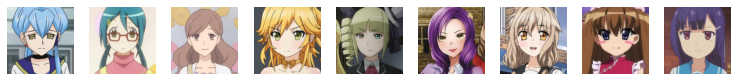

In [8]:
print ("Human Faces")
for k in range(2):
    plt.figure(figsize=(13, 13))
    for j in range(9):
        file = np.random.choice(faces)
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128,128))
        plt.subplot(990 + 1 + j)
        plt.imshow(img)
        plt.axis('off')
        #plt.title(trainY[i])
    plt.show()

print ("-"*80)
print ("Anime Faces")
for k in range(2):
    plt.figure(figsize=(13, 13))
    for j in range(9):
        file = np.random.choice(animes)
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128,128))
        plt.subplot(990 + 1 + j)
        plt.imshow(img)
        plt.axis('off')
        #plt.title(trainY[i])
    plt.show()

# Generator Model (U-Net Like)

In [9]:
import tensorflow_addons as tfa

In [10]:
def encoder_layer(input_layer, filters, bn=True):
    x = tensorflow.keras.layers.Conv2D(filters, kernel_size=(4,4), strides=(2,2), padding='same')(input_layer)
    x = tensorflow.keras.layers.LeakyReLU(alpha=0.2)(x)
    if bn:
        #x = tensorflow.keras.layers.BatchNormalization(momentum=0.8)(x)
        x = tfa.layers.InstanceNormalization()(x)
    return x

def decoder_layer(input_layer, skip_input, filters):
    #x = tensorflow.keras.layers.UpSampling2D(size=2)(input_layer)
    x = tensorflow.keras.layers.Conv2DTranspose(filters, kernel_size=(4,4), strides=(2,2), padding='same')(input_layer)
    x = tensorflow.keras.layers.Activation('relu')(x)
    #x = tensorflow.keras.layers.BatchNormalization(momentum=0.8)(x)
    x = tfa.layers.InstanceNormalization()(x)
    x = tensorflow.keras.layers.Concatenate()([x, skip_input])
    return x

In [64]:
def make_generator():
    source_image = tensorflow.keras.layers.Input(shape=(128, 128, 3))
    target_style = tensorflow.keras.layers.Input(shape=(16, 16, 512))

    e1 = encoder_layer(source_image, 64, bn=False)
    e2 = encoder_layer(e1, 128)
    e3 = encoder_layer(e2, 256)
    # e4 = encoder_layer(e3, 256)
    e5 = encoder_layer(e3, 512)
    e6 = encoder_layer(e5, 512)
    e7 = encoder_layer(e6, 512)

    bottle_neck = tensorflow.keras.layers.Conv2D(512, (4,4), strides=(2,2), padding='same')(e7)
    b = tensorflow.keras.layers.Activation('relu')(bottle_neck)

    d1 = decoder_layer(b, e7, 512)
    d2 = decoder_layer(d1, e6, 512)
    d3 = decoder_layer(d2, e5, 512)
    # d4 = decoder_layer(d3, e4, 256)
    d5 = decoder_layer(d3, e3, 256)
    d5 = tensorflow.keras.layers.Concatenate()([d5, target_style])
    d6 = decoder_layer(d5, e2, 128)
    d7 = decoder_layer(d6, e1, 64)

    decoded = tensorflow.keras.layers.Conv2DTranspose(3, kernel_size=(4,4), strides=(2,2), padding='same')(d7)
    translated_image = tensorflow.keras.layers.Activation('tanh')(decoded)
    return source_image, target_style, translated_image

source_image, target_style, translated_image = make_generator()
generator_network = tensorflow.keras.models.Model(inputs=[source_image, target_style], outputs=translated_image)
print (generator_network.summary())

Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_16 (InputLayer)           [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
conv2d_26 (Conv2D)              (None, 64, 64, 64)   3136        input_16[0][0]                   
__________________________________________________________________________________________________
leaky_re_lu_22 (LeakyReLU)      (None, 64, 64, 64)   0           conv2d_26[0][0]                  
__________________________________________________________________________________________________
conv2d_27 (Conv2D)              (None, 32, 32, 128)  131200      leaky_re_lu_22[0][0]             
____________________________________________________________________________________________

# Discriminator Network

In [65]:
def my_conv_layer(input_layer, filters, bn=True):
    x = tensorflow.keras.layers.Conv2D(filters, kernel_size=(4,4), strides=(2,2), padding='same')(input_layer)
    x = tensorflow.keras.layers.LeakyReLU(alpha=0.2)(x)
    if bn:
        #x = tensorflow.keras.layers.BatchNormalization(momentum=0.8)(x)
        x = tfa.layers.InstanceNormalization()(x)
    return x

In [66]:
 def make_discriminator():
    target_image_input = tensorflow.keras.layers.Input(shape=(128, 128, 3))

    x = my_conv_layer(target_image_input, 64, bn=False)
    x = my_conv_layer(x, 128)
    x = my_conv_layer(x, 256)
    # x = my_conv_layer(x, 512)
    x = my_conv_layer(x, 512)

    patch_features = tensorflow.keras.layers.Conv2D(1, kernel_size=(4,4), strides=(1,1), padding='same')(x)
    return target_image_input, patch_features


target_image_input, patch_features = make_discriminator()
discriminator_network = tensorflow.keras.models.Model(inputs=target_image_input, outputs=patch_features)

print (discriminator_network.summary())

Model: "model_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_18 (InputLayer)        [(None, 128, 128, 3)]     0         
_________________________________________________________________
conv2d_33 (Conv2D)           (None, 64, 64, 64)        3136      
_________________________________________________________________
leaky_re_lu_28 (LeakyReLU)   (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_34 (Conv2D)           (None, 32, 32, 128)       131200    
_________________________________________________________________
leaky_re_lu_29 (LeakyReLU)   (None, 32, 32, 128)       0         
_________________________________________________________________
instance_normalization_47 (I (None, 32, 32, 128)       256       
_________________________________________________________________
conv2d_35 (Conv2D)           (None, 16, 16, 256)       5245

In [67]:
adam_optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
discriminator_network.compile(loss='mse', optimizer=adam_optimizer, metrics=['accuracy'])

# VGG features

In [68]:
image_input = tensorflow.keras.layers.Input(shape=(128, 128, 3))

pre_trained_vgg = tensorflow.keras.applications.vgg19.VGG19(weights='imagenet', input_shape=(128, 128, 3), include_top=False)
pre_trained_vgg_model = tensorflow.keras.models.Model(inputs=pre_trained_vgg.input, outputs=pre_trained_vgg.get_layer('block4_conv4').output)

pre_trained_image_feautures = pre_trained_vgg_model(image_input)

custom_vgg = tensorflow.keras.models.Model(inputs=image_input, outputs=pre_trained_image_feautures)
print (custom_vgg.summary())

Model: "model_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_19 (InputLayer)        [(None, 128, 128, 3)]     0         
_________________________________________________________________
model_9 (Functional)         (None, 16, 16, 512)       10585152  
Total params: 10,585,152
Trainable params: 10,585,152
Non-trainable params: 0
_________________________________________________________________
None


# Customized-Face2Anime-GAN

In [70]:
source_image = tensorflow.keras.layers.Input(shape=(128, 128, 3))
target_features = tensorflow.keras.layers.Input(shape=(16, 16, 512))

# Domain Transfer
custom_vgg.trainable=False
fake_anime = generator_network([source_image, target_features])
  
discriminator_network.trainable=False

# Tell Real vs Fake
real_vs_fake = discriminator_network(fake_anime)

face2anime_gan = tensorflow.keras.models.Model(inputs =[source_image, target_features], outputs = [real_vs_fake, fake_anime, fake_anime])
face2anime_gan.summary()

Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_23 (InputLayer)           [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
input_24 (InputLayer)           [(None, 16, 16, 512) 0                                            
__________________________________________________________________________________________________
model_7 (Functional)            (None, 128, 128, 3)  42882051    input_23[0][0]                   
                                                                 input_24[0][0]                   
__________________________________________________________________________________________________
model_8 (Functional)            (None, 8, 8, 1)      2766529     model_7[1][0]             

# Custom Content Loss (vgg features Loss)

In [71]:
def custom_content_loss(y_true, y_pred):
    custom_vgg.trainable=False
    y_true_features = custom_vgg(y_true)
    y_pred_features = custom_vgg(y_pred)
    content_loss = tensorflow.keras.losses.mean_absolute_error(y_true_features, y_pred_features)
    return content_loss

def custom_content_loss2(y_true, y_pred):
    custom_vgg.trainable=False
    y_true_features = y_true
    y_pred_features = custom_vgg(y_pred)
    content_loss = tensorflow.keras.losses.mean_absolute_error(y_true_features, y_pred_features)
    return content_loss

# Compiling Models

In [93]:
face2anime_gan.compile(loss=['mse', custom_content_loss, custom_content_loss], optimizer=adam_optimizer, loss_weights=[20, 5, 0.1])

# Define Data Generators

In [84]:
def faces_to_animes(faces, styles, generator_network):
    styles = custom_vgg(styles)
    generated_samples = generator_network.predict_on_batch([faces, styles])
    return generated_samples

def get_training_samples(batch_size):
    random_files = np.random.choice(faces, size=batch_size)
    images = []
    for file in random_files:
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128, 128))
        images.append((img-127.5)/127.5)
    face_images = np.array(images)

    random_files = np.random.choice(animes, size=batch_size)
    images = []
    for file in random_files:
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128, 128))
        images.append((img-127.5)/127.5)
    anime_images = np.array(images)
    return face_images, anime_images

def show_generator_results(generator_network):
    images = []
    styles = []
    for j in range(7):
        file = np.random.choice(faces_test)
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128, 128))
        images.append(img)

        file = np.random.choice(animes_test)
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128, 128))
        styles.append(img)

    print ('Human Face Images')
    plt.figure(figsize=(13, 13))
    for j, img in enumerate(images):
        plt.subplot(770 + 1 + j)
        plt.imshow(img)
        plt.axis('off')
        #plt.title(trainY[i])
    plt.show()

    # print ('Style Images')
    # plt.figure(figsize=(13, 13))
    # for j, img in enumerate(styles):
    #     plt.subplot(770 + 1 + j)
    #     plt.imshow(img)
    #     plt.axis('off')
    #     #plt.title(trainY[i])
    # plt.show()

    print ('Customized Anime Version')
    plt.figure(figsize=(13, 13))
    for j, img in enumerate(images):
        img = (img-127.5)/127.5
        style = (styles[j]-127.5)/127.5
        output = faces_to_animes(np.array([img]), np.array([style]), generator_network)[0]
        output = (output+1.0)/2.0
        plt.subplot(770 + 1 + j)
        plt.imshow(output)
        plt.axis('off')
        #plt.title(trainY[i])
    plt.show()

# Training GAN

In [80]:
len(faces), len(animes)

(3400, 3400)

Human Face Images


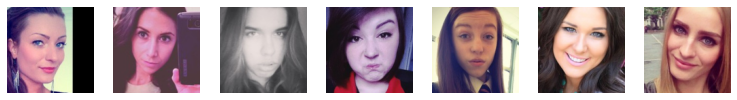

Style Images


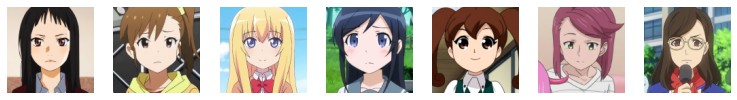

Customized Anime Version


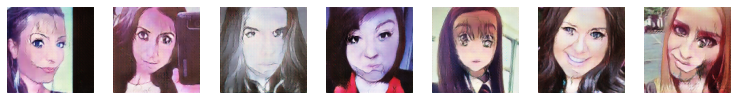

Epoch:0, Step:0, D-Loss:0.013, D-Acc:100.000, G-Loss:15.932
Epoch:0, Step:100, D-Loss:0.015, D-Acc:100.000, G-Loss:20.368
Human Face Images


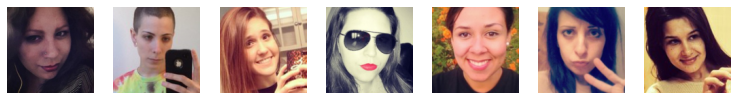

Style Images


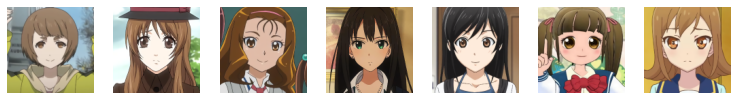

Customized Anime Version


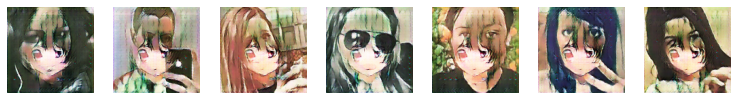

Epoch:0, Step:200, D-Loss:0.054, D-Acc:100.000, G-Loss:18.755
Epoch:0, Step:300, D-Loss:0.012, D-Acc:100.000, G-Loss:18.531
Human Face Images


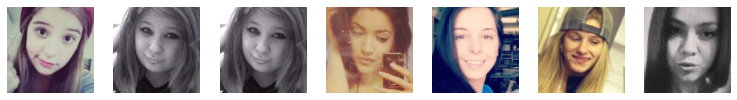

Style Images


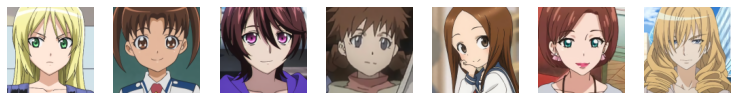

Customized Anime Version


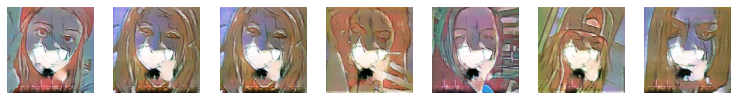

Epoch:0, Step:400, D-Loss:0.029, D-Acc:100.000, G-Loss:19.018
Epoch:0, Step:500, D-Loss:0.014, D-Acc:100.000, G-Loss:17.575
Human Face Images


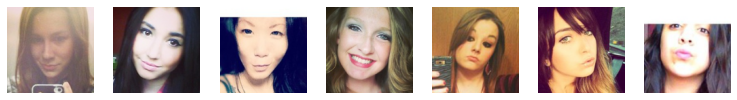

Style Images


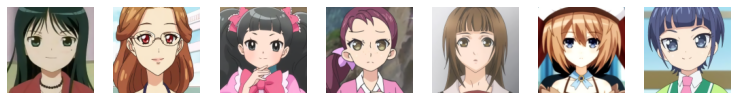

Customized Anime Version


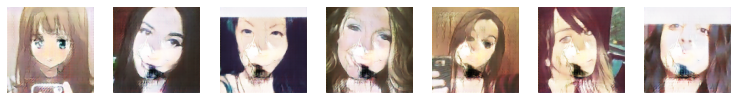

Epoch:0, Step:600, D-Loss:0.023, D-Acc:100.000, G-Loss:16.552
Epoch:0, Step:700, D-Loss:0.009, D-Acc:100.000, G-Loss:18.993
Human Face Images


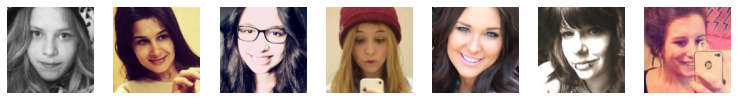

Style Images


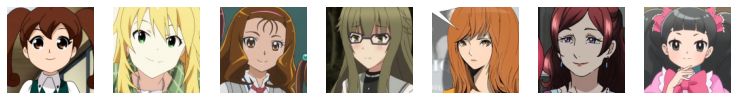

Customized Anime Version


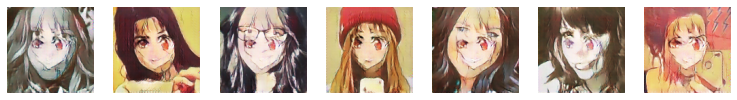

Epoch:0, Step:800, D-Loss:0.024, D-Acc:100.000, G-Loss:21.312
Epoch:0, Step:900, D-Loss:0.037, D-Acc:100.000, G-Loss:18.882
Human Face Images


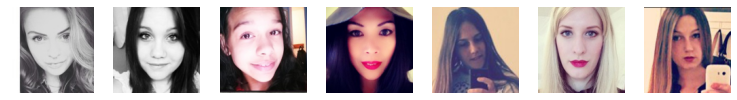

Style Images


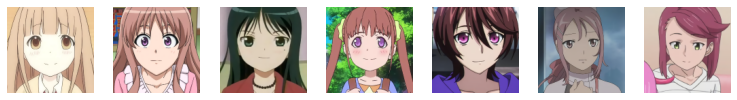

Customized Anime Version


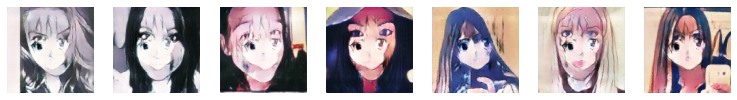

Epoch:0, Step:1000, D-Loss:0.049, D-Acc:96.094, G-Loss:17.829
Epoch:0, Step:1100, D-Loss:0.006, D-Acc:100.000, G-Loss:19.486
Human Face Images


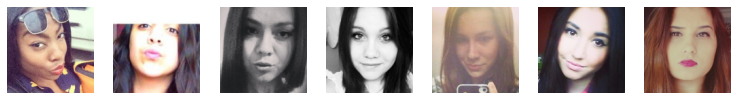

Style Images


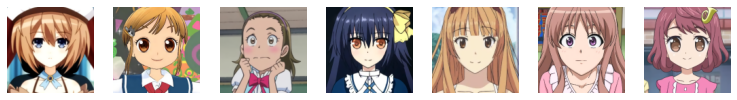

Customized Anime Version


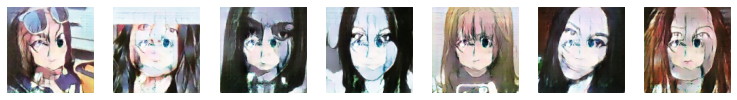

Epoch:0, Step:1200, D-Loss:0.058, D-Acc:98.438, G-Loss:18.280
Epoch:0, Step:1300, D-Loss:0.056, D-Acc:100.000, G-Loss:18.341
Human Face Images


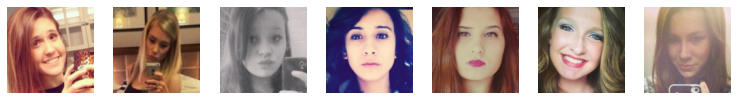

Style Images


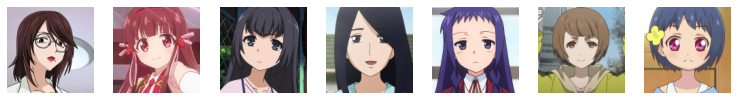

Customized Anime Version


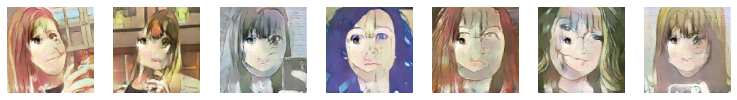

Epoch:0, Step:1400, D-Loss:0.176, D-Acc:64.844, G-Loss:17.841
Epoch:0, Step:1500, D-Loss:0.014, D-Acc:100.000, G-Loss:17.732
Human Face Images


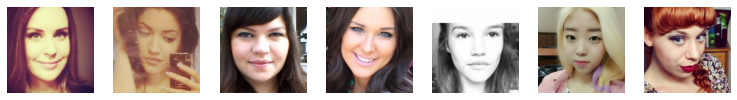

Style Images


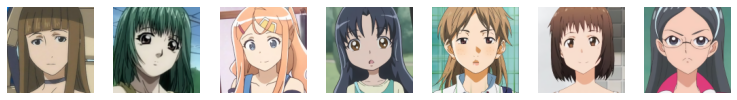

Customized Anime Version


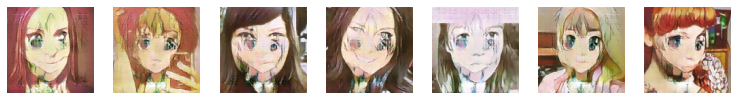

Epoch:0, Step:1600, D-Loss:0.009, D-Acc:100.000, G-Loss:18.674
Epoch:0, Step:1700, D-Loss:0.033, D-Acc:100.000, G-Loss:18.733
Human Face Images


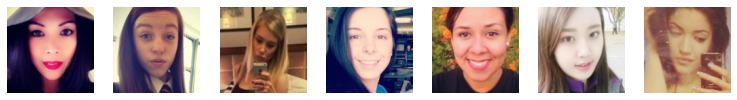

Style Images


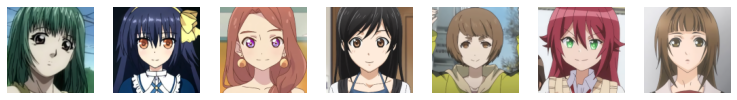

Customized Anime Version


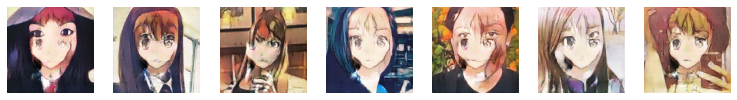

Epoch:0, Step:1800, D-Loss:0.054, D-Acc:100.000, G-Loss:17.506
Epoch:0, Step:1900, D-Loss:0.017, D-Acc:100.000, G-Loss:17.752
Human Face Images


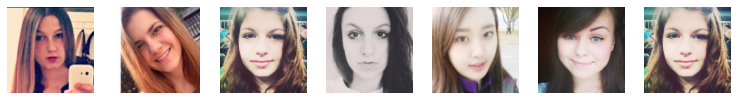

Style Images


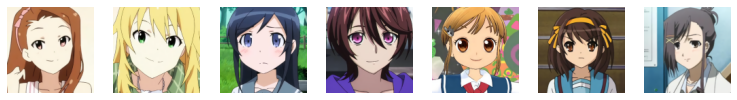

Customized Anime Version


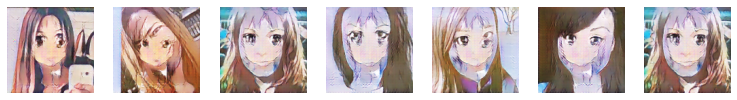

Epoch:0, Step:2000, D-Loss:0.014, D-Acc:100.000, G-Loss:19.396
Epoch:0, Step:2100, D-Loss:0.033, D-Acc:100.000, G-Loss:19.791
Human Face Images


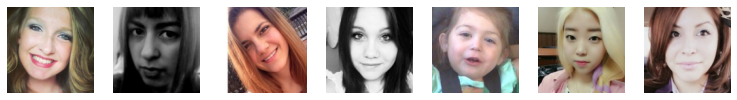

Style Images


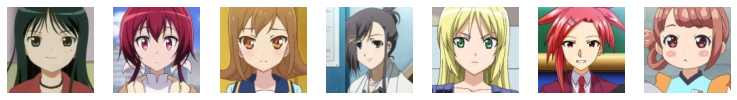

Customized Anime Version


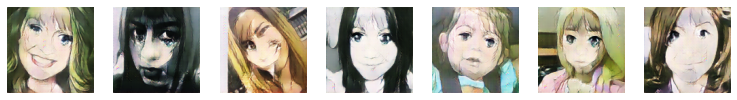

Epoch:0, Step:2200, D-Loss:0.082, D-Acc:92.969, G-Loss:15.697
Epoch:0, Step:2300, D-Loss:0.006, D-Acc:100.000, G-Loss:17.901
Human Face Images


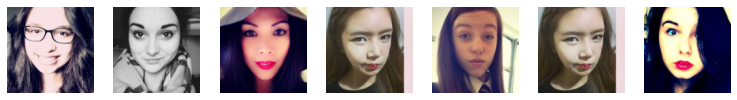

Style Images


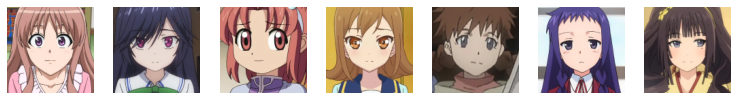

Customized Anime Version


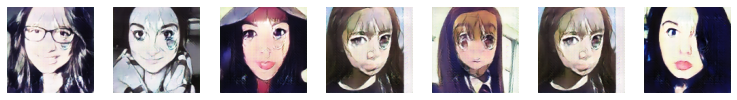

Epoch:0, Step:2400, D-Loss:0.040, D-Acc:99.219, G-Loss:18.078
Epoch:0, Step:2500, D-Loss:0.010, D-Acc:100.000, G-Loss:19.411
Human Face Images


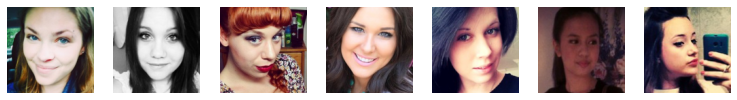

Style Images


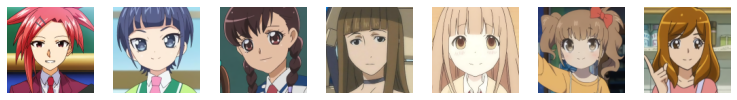

Customized Anime Version


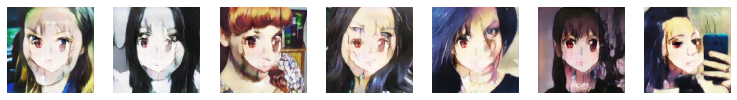

Epoch:0, Step:2600, D-Loss:0.010, D-Acc:100.000, G-Loss:18.995
Epoch:0, Step:2700, D-Loss:0.012, D-Acc:100.000, G-Loss:18.472
Human Face Images


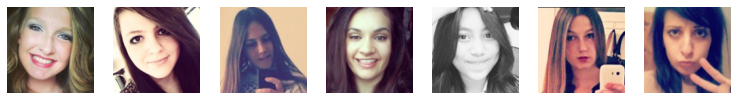

Style Images


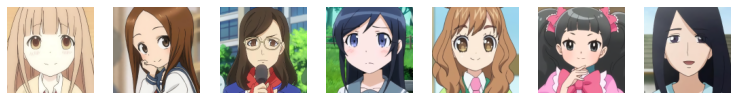

Customized Anime Version


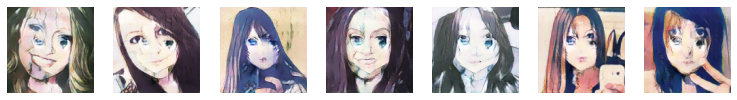

Epoch:0, Step:2800, D-Loss:0.066, D-Acc:99.219, G-Loss:15.830
Epoch:0, Step:2900, D-Loss:0.041, D-Acc:100.000, G-Loss:17.572
Human Face Images


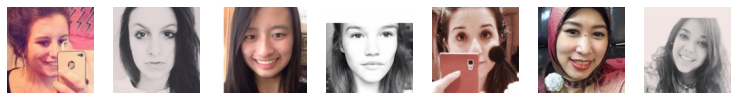

Style Images


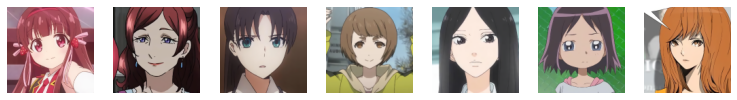

Customized Anime Version


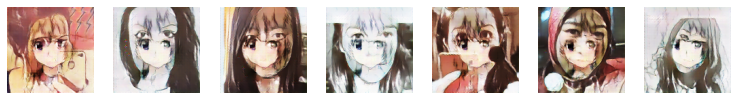

Epoch:0, Step:3000, D-Loss:0.051, D-Acc:100.000, G-Loss:16.493
Epoch:0, Step:3100, D-Loss:0.041, D-Acc:100.000, G-Loss:19.886
Human Face Images


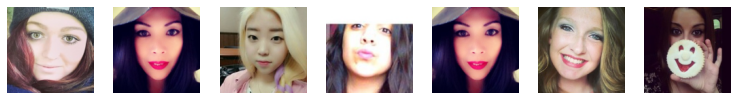

Style Images


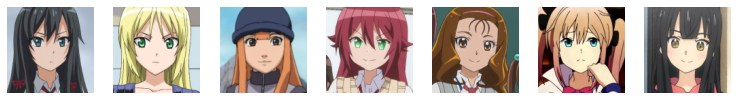

Customized Anime Version


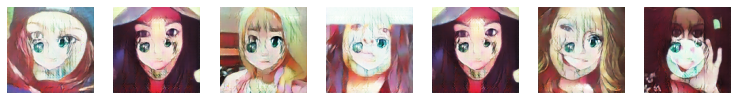

Epoch:0, Step:3200, D-Loss:0.058, D-Acc:100.000, G-Loss:20.574
Epoch:0, Step:3300, D-Loss:0.017, D-Acc:100.000, G-Loss:19.261
Human Face Images


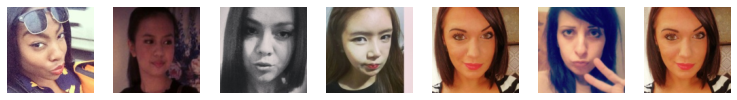

Style Images


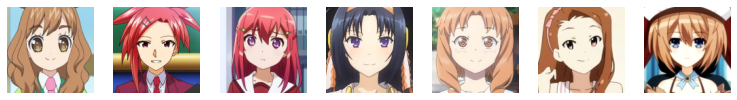

Customized Anime Version


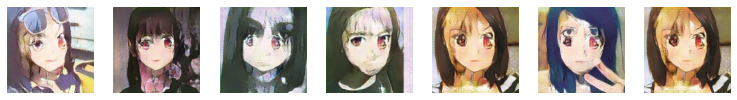

Epoch:1, Step:0, D-Loss:0.040, D-Acc:99.219, G-Loss:17.263
Epoch:1, Step:100, D-Loss:0.069, D-Acc:97.656, G-Loss:18.376
Human Face Images


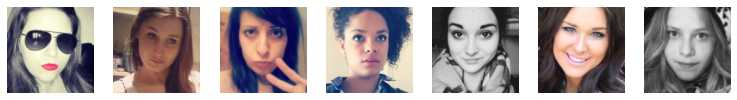

Style Images


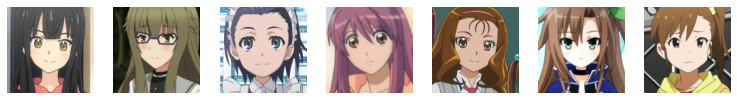

Customized Anime Version


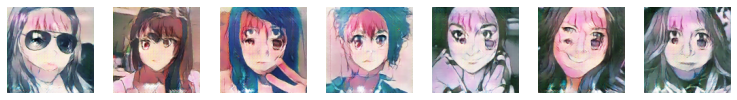

Epoch:1, Step:200, D-Loss:0.012, D-Acc:100.000, G-Loss:19.708
Epoch:1, Step:300, D-Loss:0.027, D-Acc:100.000, G-Loss:18.610
Human Face Images


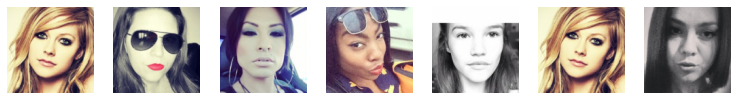

Style Images


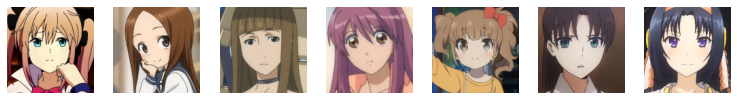

Customized Anime Version


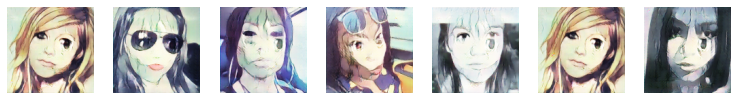

Epoch:1, Step:400, D-Loss:0.029, D-Acc:100.000, G-Loss:18.520
Epoch:1, Step:500, D-Loss:0.023, D-Acc:100.000, G-Loss:17.946
Human Face Images


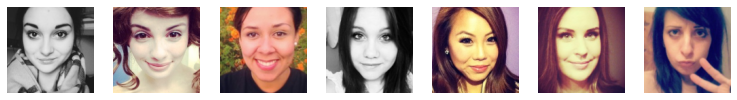

Style Images


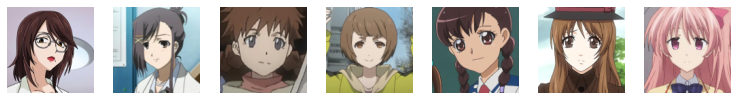

Customized Anime Version


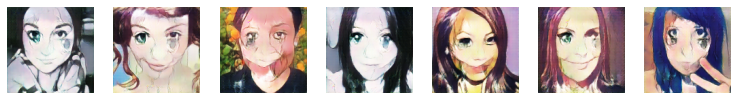

Epoch:1, Step:600, D-Loss:0.213, D-Acc:57.812, G-Loss:17.858
Epoch:1, Step:700, D-Loss:0.031, D-Acc:100.000, G-Loss:17.102
Human Face Images


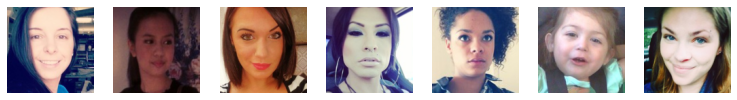

Style Images


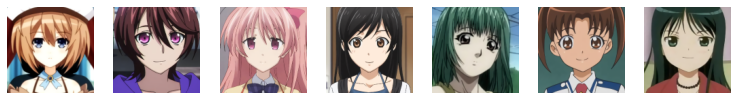

Customized Anime Version


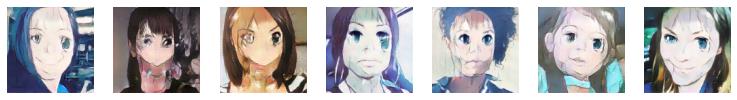

Epoch:1, Step:800, D-Loss:0.099, D-Acc:86.719, G-Loss:15.435
Epoch:1, Step:900, D-Loss:0.063, D-Acc:99.219, G-Loss:18.049
Human Face Images


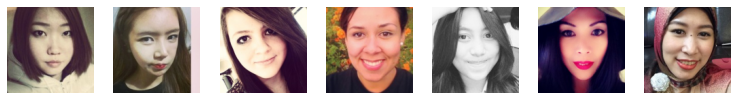

Style Images


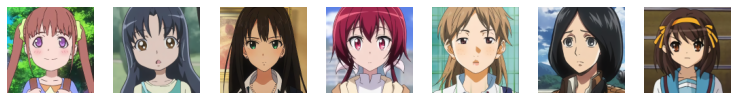

Customized Anime Version


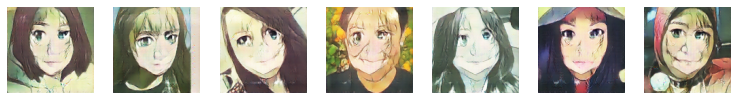

Epoch:1, Step:1000, D-Loss:0.159, D-Acc:76.562, G-Loss:18.168
Epoch:1, Step:1100, D-Loss:0.024, D-Acc:100.000, G-Loss:20.563
Human Face Images


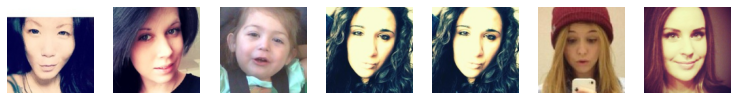

Style Images


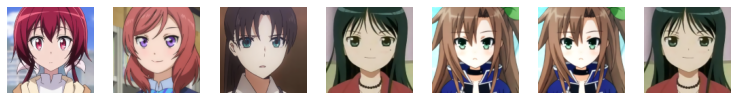

Customized Anime Version


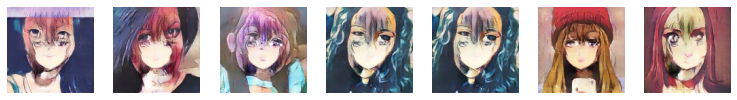

Epoch:1, Step:1200, D-Loss:0.111, D-Acc:88.281, G-Loss:22.181
Epoch:1, Step:1300, D-Loss:0.032, D-Acc:100.000, G-Loss:18.427
Human Face Images


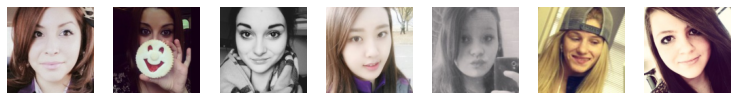

Style Images


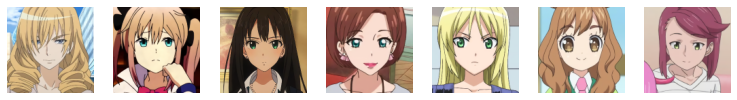

Customized Anime Version


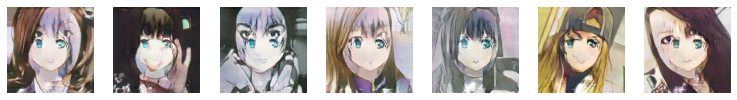

Epoch:1, Step:1400, D-Loss:0.018, D-Acc:100.000, G-Loss:19.177
Epoch:1, Step:1500, D-Loss:0.022, D-Acc:100.000, G-Loss:18.015
Human Face Images


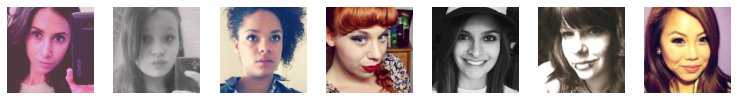

Style Images


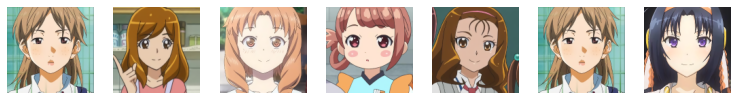

Customized Anime Version


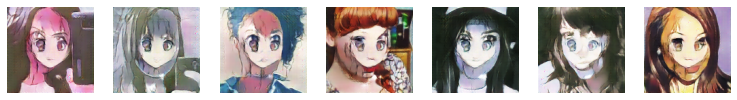

Epoch:1, Step:1600, D-Loss:0.022, D-Acc:100.000, G-Loss:18.267
Epoch:1, Step:1700, D-Loss:0.041, D-Acc:100.000, G-Loss:16.557
Human Face Images


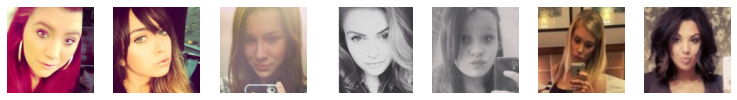

Style Images


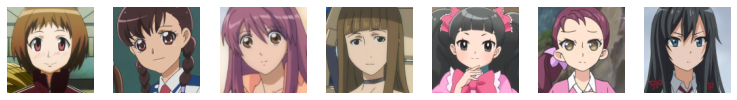

Customized Anime Version


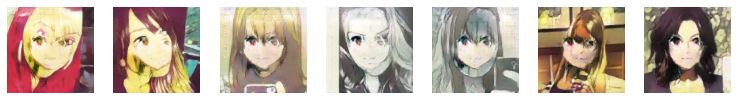

Epoch:1, Step:1800, D-Loss:0.055, D-Acc:95.312, G-Loss:17.519
Epoch:1, Step:1900, D-Loss:0.020, D-Acc:100.000, G-Loss:17.523
Human Face Images


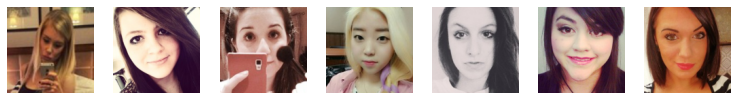

Style Images


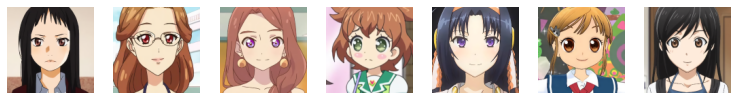

Customized Anime Version


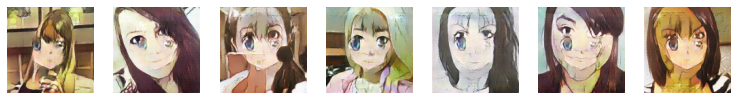

Epoch:1, Step:2000, D-Loss:0.016, D-Acc:100.000, G-Loss:19.813
Epoch:1, Step:2100, D-Loss:0.012, D-Acc:100.000, G-Loss:18.129
Human Face Images


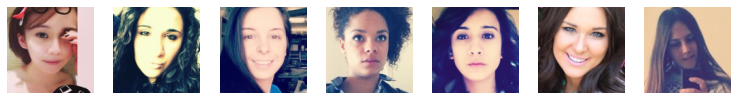

Style Images


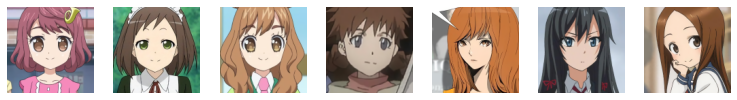

Customized Anime Version


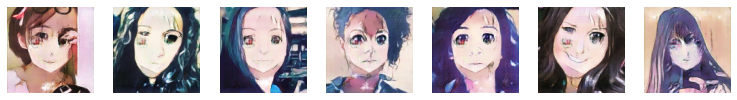

Epoch:1, Step:2200, D-Loss:0.010, D-Acc:100.000, G-Loss:17.304
Epoch:1, Step:2300, D-Loss:0.055, D-Acc:97.656, G-Loss:16.481
Human Face Images


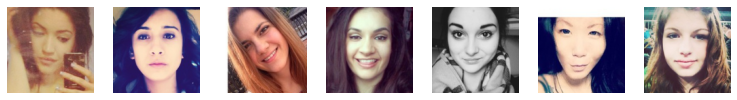

Style Images


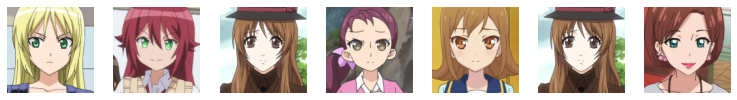

Customized Anime Version


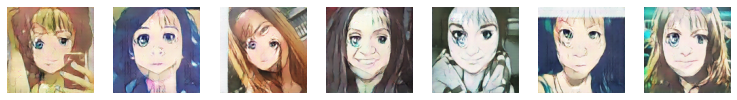

Epoch:1, Step:2400, D-Loss:0.106, D-Acc:91.406, G-Loss:19.852
Epoch:1, Step:2500, D-Loss:0.030, D-Acc:100.000, G-Loss:20.915
Human Face Images


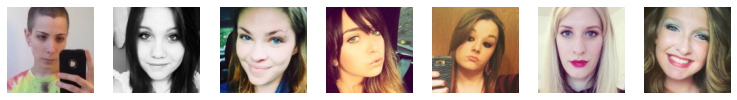

Style Images


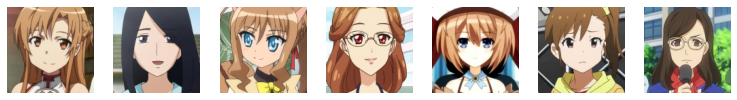

Customized Anime Version


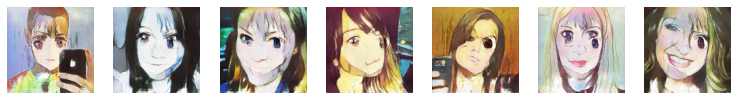

Epoch:1, Step:2600, D-Loss:0.058, D-Acc:100.000, G-Loss:17.931
Epoch:1, Step:2700, D-Loss:0.050, D-Acc:100.000, G-Loss:17.980
Human Face Images


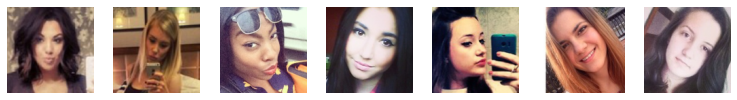

Style Images


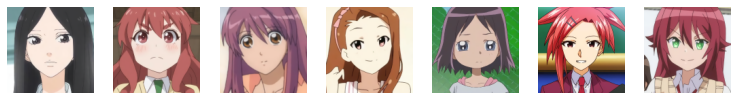

Customized Anime Version


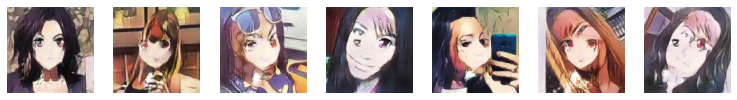

Epoch:1, Step:2800, D-Loss:0.545, D-Acc:4.688, G-Loss:18.615
Epoch:1, Step:2900, D-Loss:0.012, D-Acc:100.000, G-Loss:18.208
Human Face Images


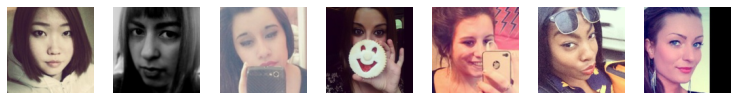

Style Images


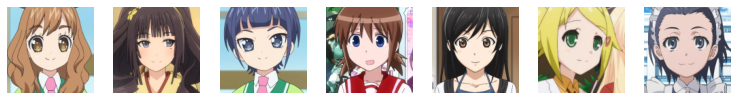

Customized Anime Version


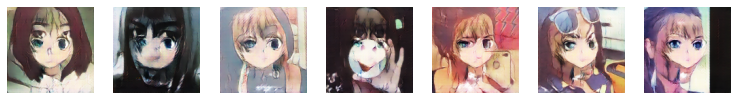

Epoch:1, Step:3000, D-Loss:0.066, D-Acc:99.219, G-Loss:17.610
Epoch:1, Step:3100, D-Loss:0.108, D-Acc:85.938, G-Loss:17.279
Human Face Images


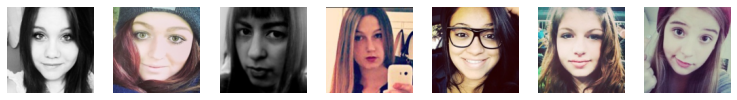

Style Images


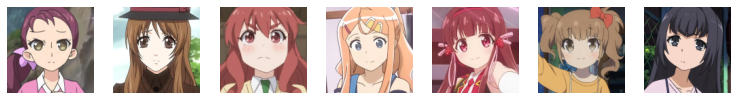

Customized Anime Version


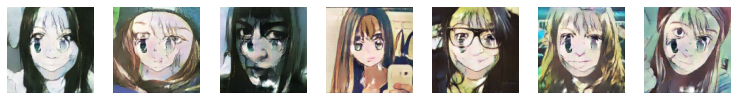

Epoch:1, Step:3200, D-Loss:0.010, D-Acc:100.000, G-Loss:17.446
Epoch:1, Step:3300, D-Loss:0.014, D-Acc:100.000, G-Loss:17.648
Human Face Images


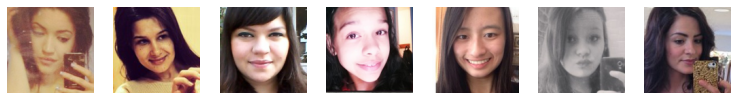

Style Images


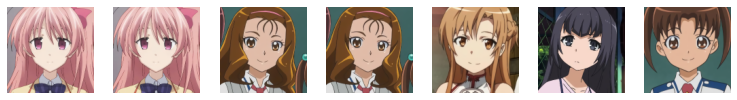

Customized Anime Version


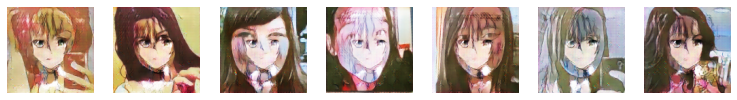

Epoch:2, Step:0, D-Loss:0.013, D-Acc:100.000, G-Loss:19.981
Epoch:2, Step:100, D-Loss:0.032, D-Acc:100.000, G-Loss:21.403
Human Face Images


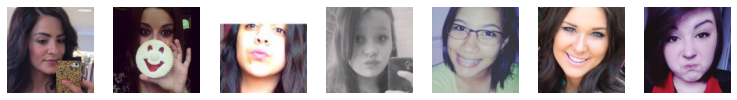

Style Images


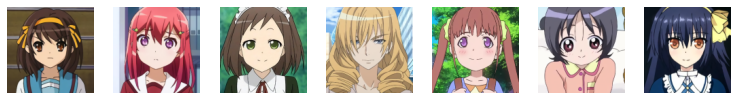

Customized Anime Version


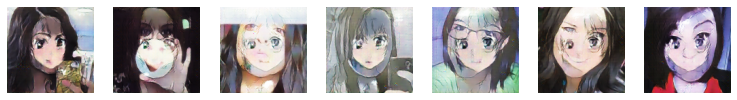

Epoch:2, Step:200, D-Loss:0.036, D-Acc:100.000, G-Loss:17.883
Epoch:2, Step:300, D-Loss:0.267, D-Acc:53.906, G-Loss:17.218
Human Face Images


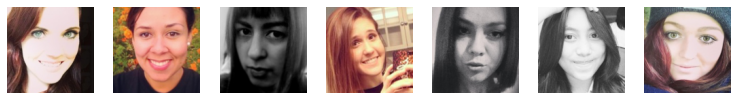

Style Images


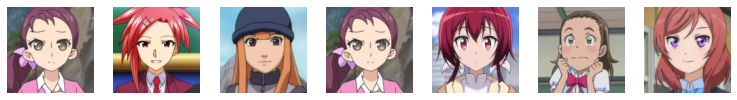

Customized Anime Version


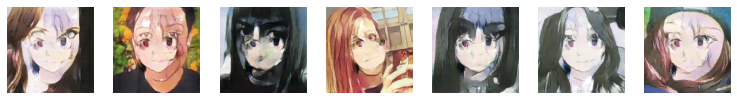

Epoch:2, Step:400, D-Loss:0.027, D-Acc:100.000, G-Loss:18.514
Epoch:2, Step:500, D-Loss:0.018, D-Acc:100.000, G-Loss:18.520
Human Face Images


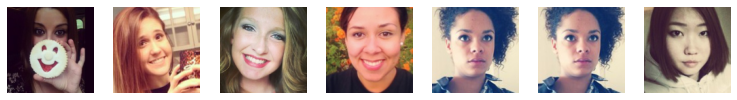

Style Images


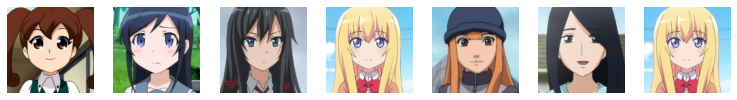

Customized Anime Version


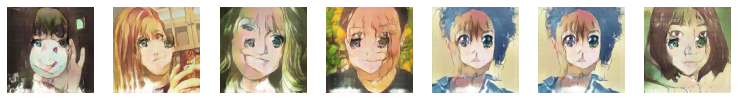

Epoch:2, Step:600, D-Loss:0.048, D-Acc:99.219, G-Loss:19.752
Epoch:2, Step:700, D-Loss:0.014, D-Acc:100.000, G-Loss:18.177
Human Face Images


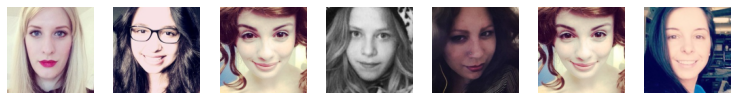

Style Images


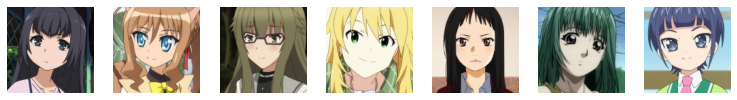

Customized Anime Version


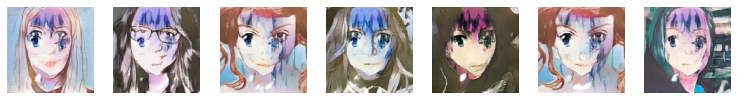

Epoch:2, Step:800, D-Loss:0.017, D-Acc:100.000, G-Loss:19.657
Epoch:2, Step:900, D-Loss:0.013, D-Acc:100.000, G-Loss:18.549
Human Face Images


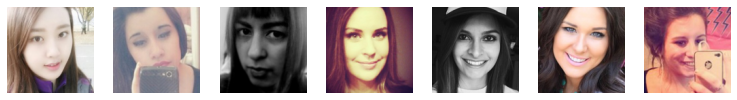

Style Images


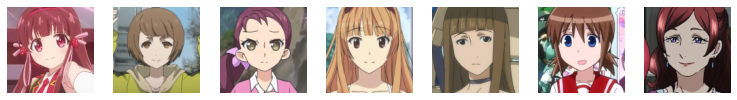

Customized Anime Version


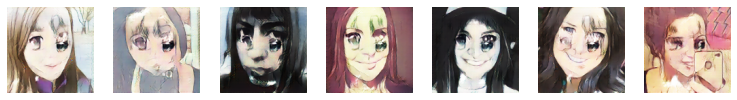

Epoch:2, Step:1000, D-Loss:0.022, D-Acc:100.000, G-Loss:21.992
Epoch:2, Step:1100, D-Loss:0.034, D-Acc:100.000, G-Loss:17.367
Human Face Images


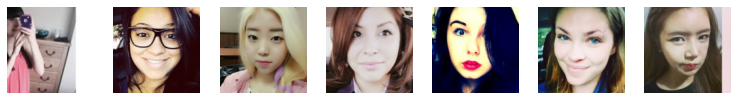

Style Images


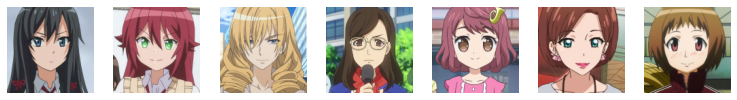

Customized Anime Version


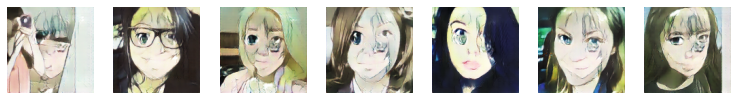

Epoch:2, Step:1200, D-Loss:0.105, D-Acc:83.594, G-Loss:18.404
Epoch:2, Step:1300, D-Loss:0.146, D-Acc:75.000, G-Loss:21.947
Human Face Images


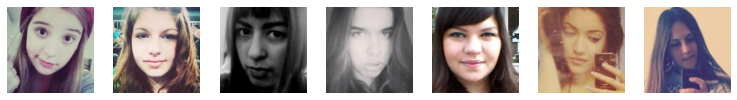

Style Images


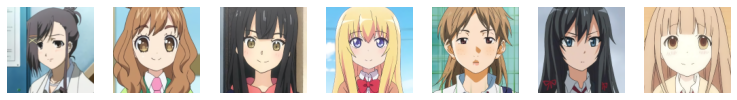

Customized Anime Version


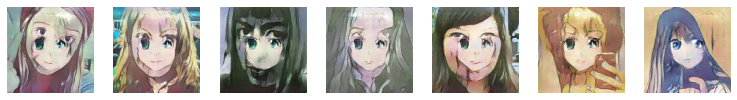

Epoch:2, Step:1400, D-Loss:0.078, D-Acc:99.219, G-Loss:20.116
Epoch:2, Step:1500, D-Loss:0.031, D-Acc:100.000, G-Loss:16.337
Human Face Images


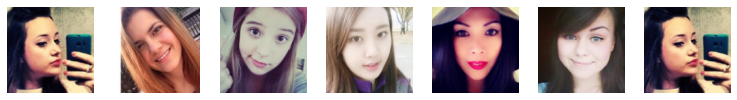

Style Images


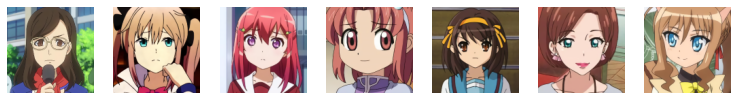

Customized Anime Version


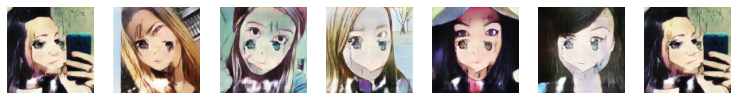

Epoch:2, Step:1600, D-Loss:0.014, D-Acc:100.000, G-Loss:18.637
Epoch:2, Step:1700, D-Loss:0.073, D-Acc:98.438, G-Loss:18.348
Human Face Images


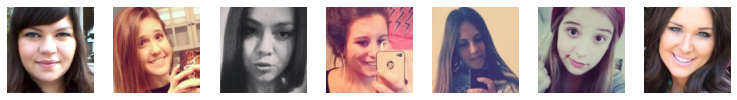

Style Images


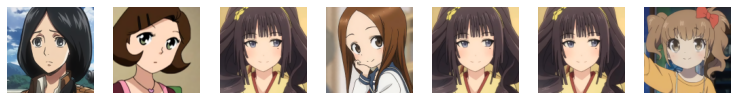

Customized Anime Version


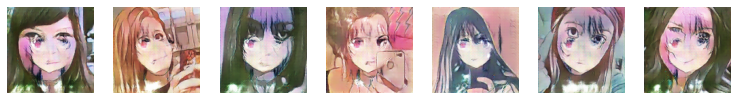

Epoch:2, Step:1800, D-Loss:0.022, D-Acc:100.000, G-Loss:18.497
Epoch:2, Step:1900, D-Loss:0.015, D-Acc:100.000, G-Loss:19.119
Human Face Images


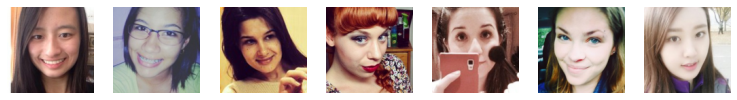

Style Images


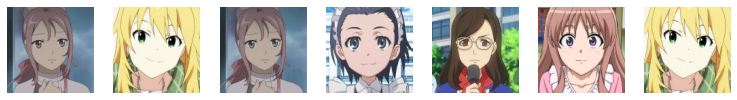

Customized Anime Version


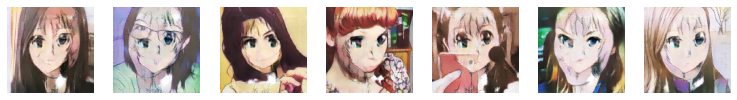

Epoch:2, Step:2000, D-Loss:0.008, D-Acc:100.000, G-Loss:19.424
Epoch:2, Step:2100, D-Loss:0.302, D-Acc:50.000, G-Loss:14.594
Human Face Images


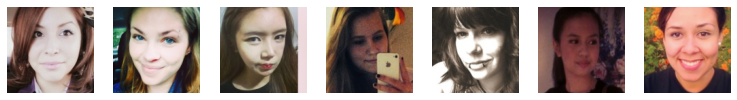

Style Images


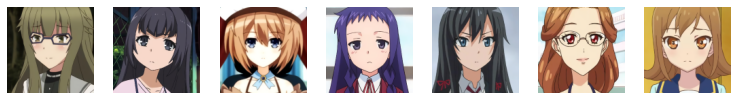

Customized Anime Version


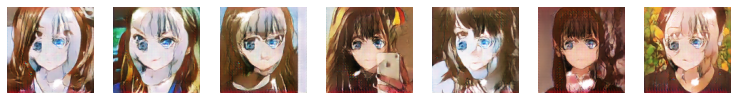

Epoch:2, Step:2200, D-Loss:0.057, D-Acc:100.000, G-Loss:20.204
Epoch:2, Step:2300, D-Loss:0.008, D-Acc:100.000, G-Loss:18.101
Human Face Images


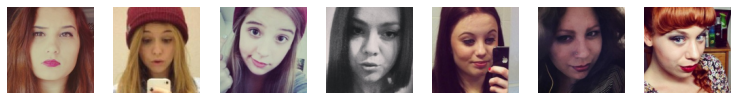

Style Images


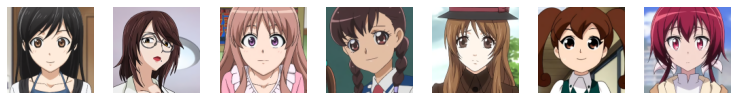

Customized Anime Version


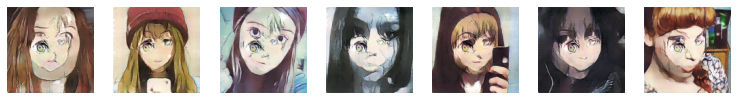

Epoch:2, Step:2400, D-Loss:0.007, D-Acc:100.000, G-Loss:18.749
Epoch:2, Step:2500, D-Loss:0.044, D-Acc:100.000, G-Loss:18.275
Human Face Images


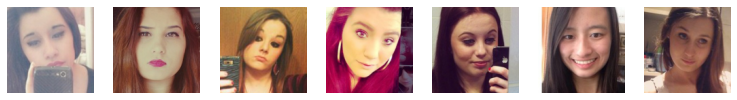

Style Images


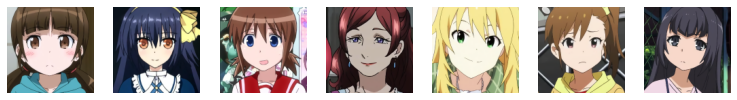

Customized Anime Version


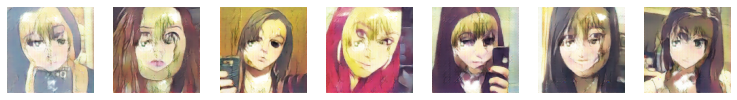

Epoch:2, Step:2600, D-Loss:0.014, D-Acc:100.000, G-Loss:17.129
Epoch:2, Step:2700, D-Loss:0.075, D-Acc:96.094, G-Loss:19.127
Human Face Images


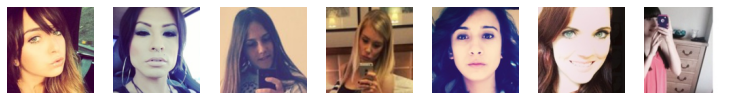

Style Images


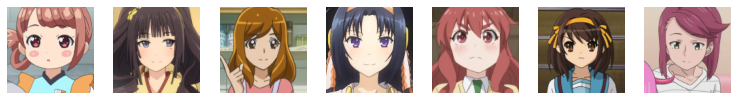

Customized Anime Version


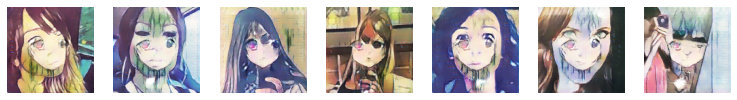

Epoch:2, Step:2800, D-Loss:0.018, D-Acc:100.000, G-Loss:18.083
Epoch:2, Step:2900, D-Loss:0.009, D-Acc:100.000, G-Loss:17.614
Human Face Images


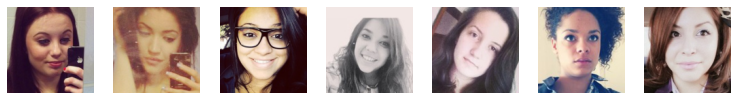

Style Images


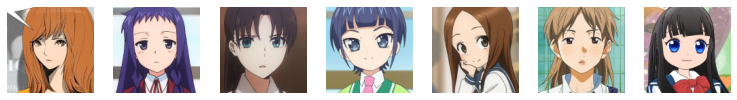

Customized Anime Version


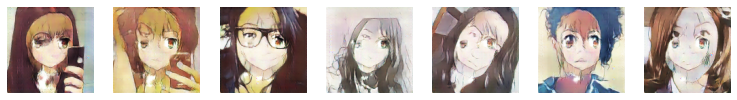

Epoch:2, Step:3000, D-Loss:0.056, D-Acc:100.000, G-Loss:17.651
Epoch:2, Step:3100, D-Loss:0.012, D-Acc:100.000, G-Loss:17.830
Human Face Images


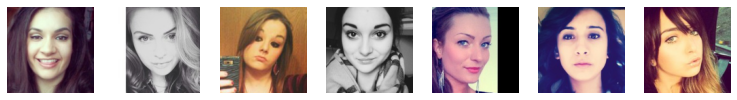

Style Images


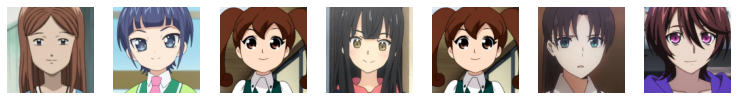

Customized Anime Version


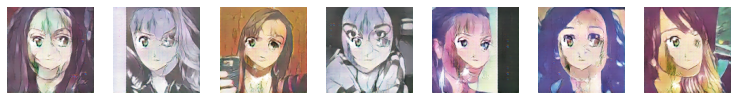

Epoch:2, Step:3200, D-Loss:0.390, D-Acc:46.094, G-Loss:17.526
Epoch:2, Step:3300, D-Loss:0.020, D-Acc:100.000, G-Loss:18.631
Human Face Images


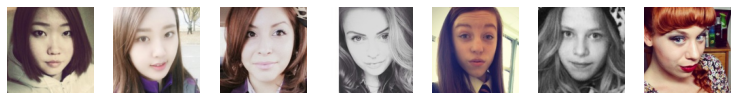

Style Images


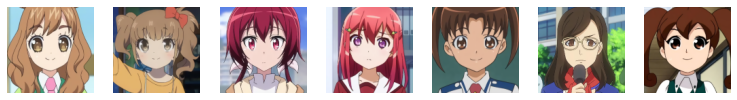

Customized Anime Version


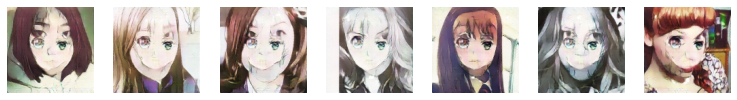

Epoch:3, Step:0, D-Loss:0.019, D-Acc:100.000, G-Loss:17.797
Epoch:3, Step:100, D-Loss:0.012, D-Acc:100.000, G-Loss:18.362
Human Face Images


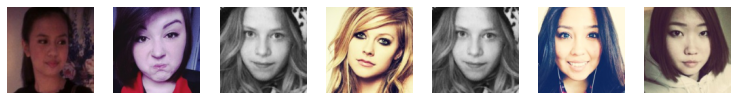

Style Images


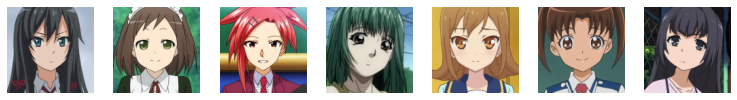

Customized Anime Version


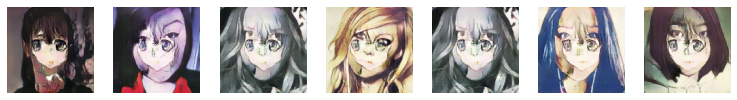

Epoch:3, Step:200, D-Loss:0.006, D-Acc:100.000, G-Loss:17.765
Epoch:3, Step:300, D-Loss:0.023, D-Acc:100.000, G-Loss:18.165
Human Face Images


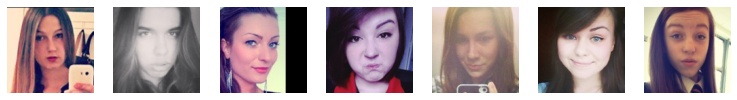

Style Images


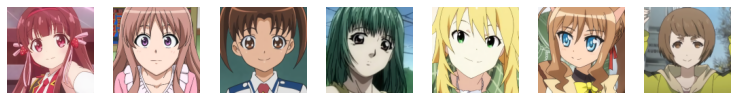

Customized Anime Version


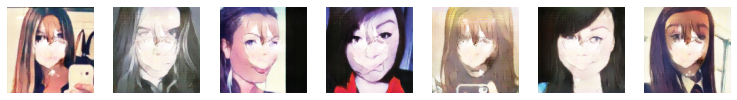

Epoch:3, Step:400, D-Loss:0.007, D-Acc:100.000, G-Loss:17.682
Epoch:3, Step:500, D-Loss:0.020, D-Acc:100.000, G-Loss:16.390
Human Face Images


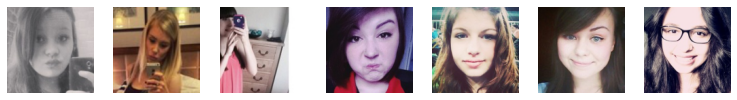

Style Images


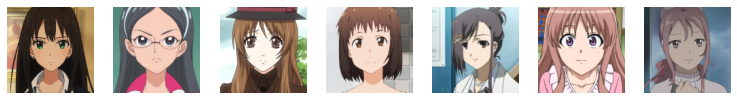

Customized Anime Version


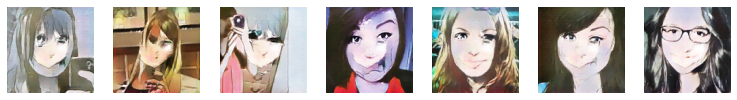

Epoch:3, Step:600, D-Loss:0.008, D-Acc:100.000, G-Loss:17.747
Epoch:3, Step:700, D-Loss:0.012, D-Acc:100.000, G-Loss:18.004
Human Face Images


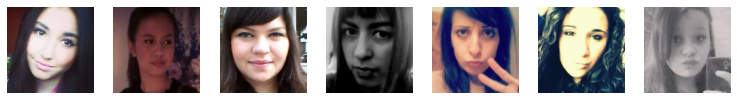

Style Images


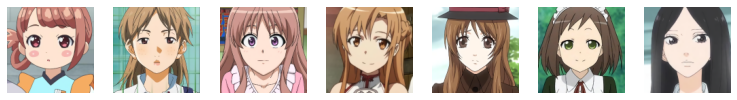

Customized Anime Version


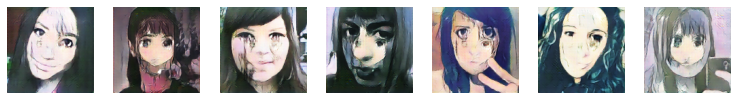

Epoch:3, Step:800, D-Loss:0.183, D-Acc:81.250, G-Loss:17.386
Epoch:3, Step:900, D-Loss:0.023, D-Acc:100.000, G-Loss:18.200
Human Face Images


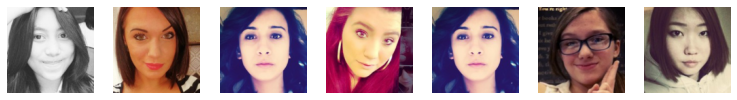

Style Images


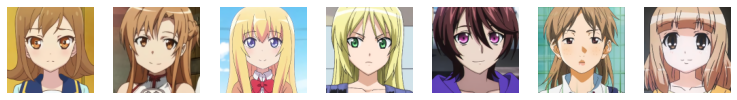

Customized Anime Version


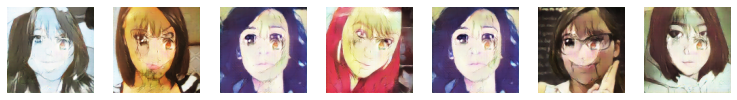

Epoch:3, Step:1000, D-Loss:0.030, D-Acc:99.219, G-Loss:17.481
Epoch:3, Step:1100, D-Loss:0.015, D-Acc:100.000, G-Loss:19.635
Human Face Images


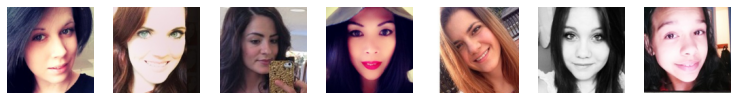

Style Images


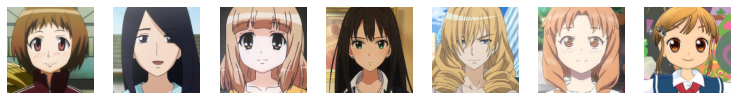

Customized Anime Version


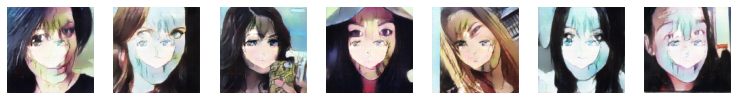

Epoch:3, Step:1200, D-Loss:0.015, D-Acc:100.000, G-Loss:18.323
Epoch:3, Step:1300, D-Loss:0.020, D-Acc:100.000, G-Loss:17.737
Human Face Images


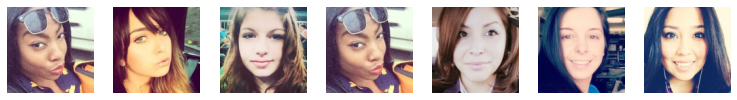

Style Images


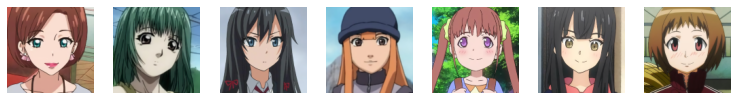

Customized Anime Version


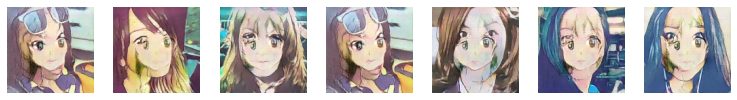

Epoch:3, Step:1400, D-Loss:0.013, D-Acc:100.000, G-Loss:21.126
Epoch:3, Step:1500, D-Loss:0.008, D-Acc:100.000, G-Loss:18.679
Human Face Images


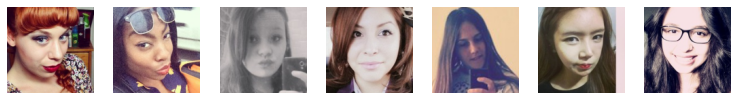

Style Images


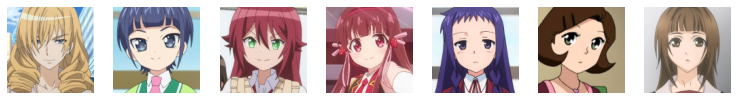

Customized Anime Version


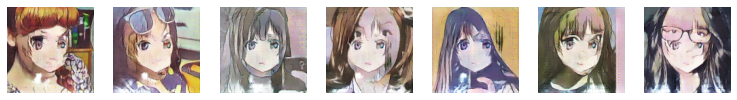

Epoch:3, Step:1600, D-Loss:0.022, D-Acc:100.000, G-Loss:19.992
Epoch:3, Step:1700, D-Loss:0.005, D-Acc:100.000, G-Loss:18.582
Human Face Images


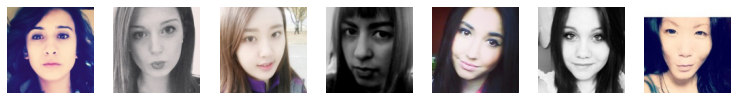

Style Images


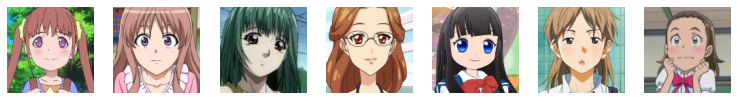

Customized Anime Version


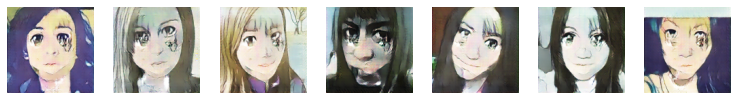

Epoch:3, Step:1800, D-Loss:0.027, D-Acc:100.000, G-Loss:16.900
Epoch:3, Step:1900, D-Loss:0.009, D-Acc:100.000, G-Loss:17.981
Human Face Images


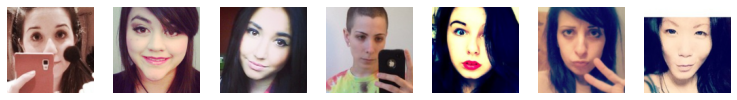

Style Images


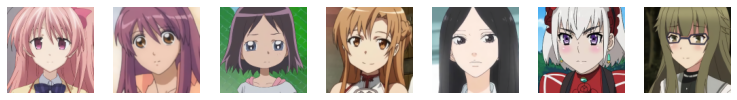

Customized Anime Version


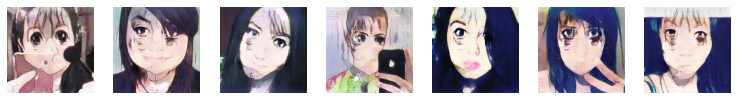

Epoch:3, Step:2000, D-Loss:0.011, D-Acc:100.000, G-Loss:20.031
Epoch:3, Step:2100, D-Loss:0.020, D-Acc:100.000, G-Loss:20.444
Human Face Images


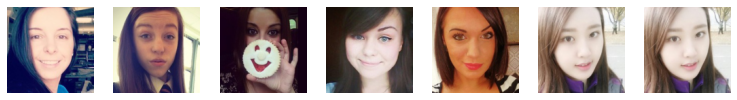

Style Images


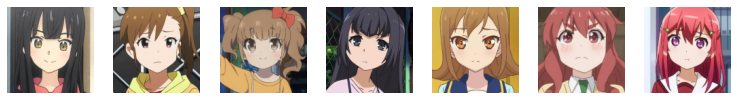

Customized Anime Version


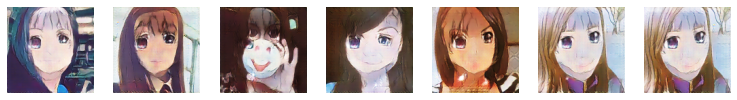

Epoch:3, Step:2200, D-Loss:0.014, D-Acc:100.000, G-Loss:18.373
Epoch:3, Step:2300, D-Loss:0.014, D-Acc:100.000, G-Loss:17.308
Human Face Images


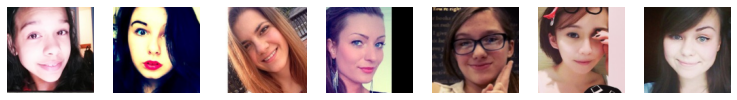

Style Images


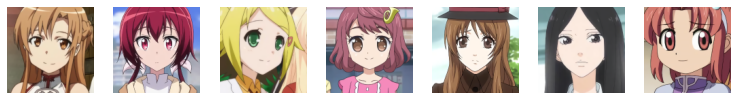

Customized Anime Version


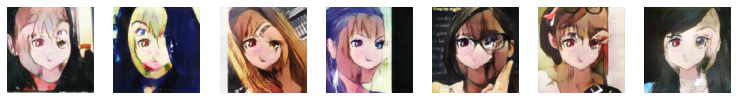

Epoch:3, Step:2400, D-Loss:0.069, D-Acc:94.531, G-Loss:20.528


KeyboardInterrupt: ignored

In [83]:
epochs = 500
batch_size = 1
steps = 3400

for i in range(0, epochs):
    # if i%1 == 0:
    #     show_generator_results(generator_network)
    for j in range(steps): 
        if j%200 == 0:
            show_generator_results(generator_network) 

        human_faces, anime_faces = get_training_samples(batch_size)

        fake_patch = np.zeros((batch_size, 8, 8, 1))
        real_patch = np.ones((batch_size, 8, 8, 1))
        
        custom_vgg.trainable=False
        styles = custom_vgg(anime_faces)
        fake_anime_faces = generator_network([human_faces, styles])
        
        # Updating Discriminator weights
        discriminator_network.trainable=True
        loss_d_real = discriminator_network.train_on_batch(anime_faces, real_patch)
        loss_d_fake = discriminator_network.train_on_batch(fake_anime_faces, fake_patch)

        loss_d = np.add(loss_d_real, loss_d_fake)/2.0
        
        # Make the Discriminator belive that these are real samples and calculate loss to train the generator
        discriminator_network.trainable=False
        # custom_vgg.trainable=False
        # y_true_features1 = custom_vgg(human_faces)
        # y_true_features2 = custom_vgg(anime_faces)

        # avg_features = np.add(y_true_features1, y_true_features2)/2.0

        # Updating Generator weights
        loss_g = face2anime_gan.train_on_batch([human_faces, anime_faces],[real_patch, human_faces, anime_faces])
        
        if j%100 == 0:
            print ("Epoch:%.0f, Step:%.0f, D-Loss:%.3f, D-Acc:%.3f, G-Loss:%.3f"%(i,j,loss_d[0],loss_d[1]*100,loss_g[0]))
            

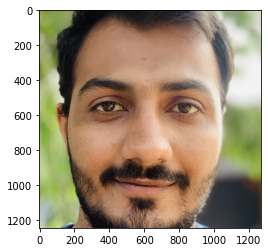

In [5]:
import tensorflow
import cv2
import matplotlib.pyplot as plt
model = tensorflow.keras.models.load_model('/content/gdrive/MyDrive/GAN_datasets/face_to_anime_0_0')
img = cv2.imread('/content/gdrive/MyDrive/GAN_datasets/kartik1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.show()

In [7]:
img2 = cv2.resize(img, (128, 128))
img2 = ((img2-127.5)/127.5)
anime = model.predict_on_batch(np.array([img2], styles))[0]
anime = (anime + 1.0)/2.0
plt.imshow(anime)
plt.show()

NameError: ignored